<a href="https://colab.research.google.com/github/JunyuYan/Pytorch-Learning-Materials/blob/main/pytorch_examples/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Generative Adversarial Networks

GANs are a framework for teaching a deep learning model to capture the training data distribution so we can generate new data from that same distribution. More detailed description of GAN can be found in this [paper](https://arxiv.org/abs/1406.2661).

GAN consists of two parts: G (Generator) and D (Discriminator)


*   G： G is a generator network to generate images. It accepts a random noise z and uses this z to generate new images as $G(z)$.

*   D：D is a discriminator network to judge whether the image is a real training image. It gets an input image x and then outputs $D(x)$ to indicate the probability of the input image being real. If $D(x)=1$, then x must be a real training image. While if $D(x)=0$, then x must be a fake image created by the generator.

During the training process, the generator is always trying to generate images as real as possible to deceive the network; however, the discriminator is working to become a good detective and correctly classify the real and fake images. Therefore, D and G form a "game process".

The equilibrium of this game is: the generator is generating perfect fakes that look as if they came directly from the training data, and the discriminator is left to always guess at 50% confidence that the generator output is real or fake (Discriminator cannot distinguish fake and real images).

To describe GAN in mathematics description, we have: 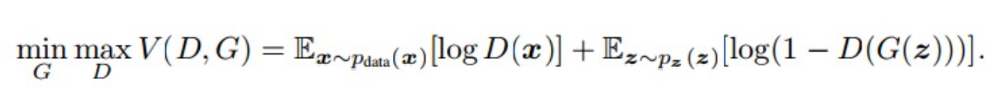





Here:


*   $x$ represents the real images, z is the input random noise, and $G(z)$ represents the images generated by G.
*  $D(x)$ is the discriminator network which outputs the (scalar) probability that $x$ came from training data rather than the generator. $D(x)$ should be approaching 1. $D(G(z))$ is the probability (scalar) that the output of the generator $G$ is a real image.


*  Goals of $G$: estimate the distribution that the training data come from, and generate fake samples as real as possible. Therefore, G tries to maximize $D(G(z))$, and this leads to decreasing $V(D, G)$, as $min G$ shown in the equation.
*   Goal of $D$: correctly classify real and fake images. Therefore, D tries to maximize $D(x)$ and minimize $D(G(z))$, leading to a larger $V(D, G)$ and the $max D$.

The following image clearly describes this process:
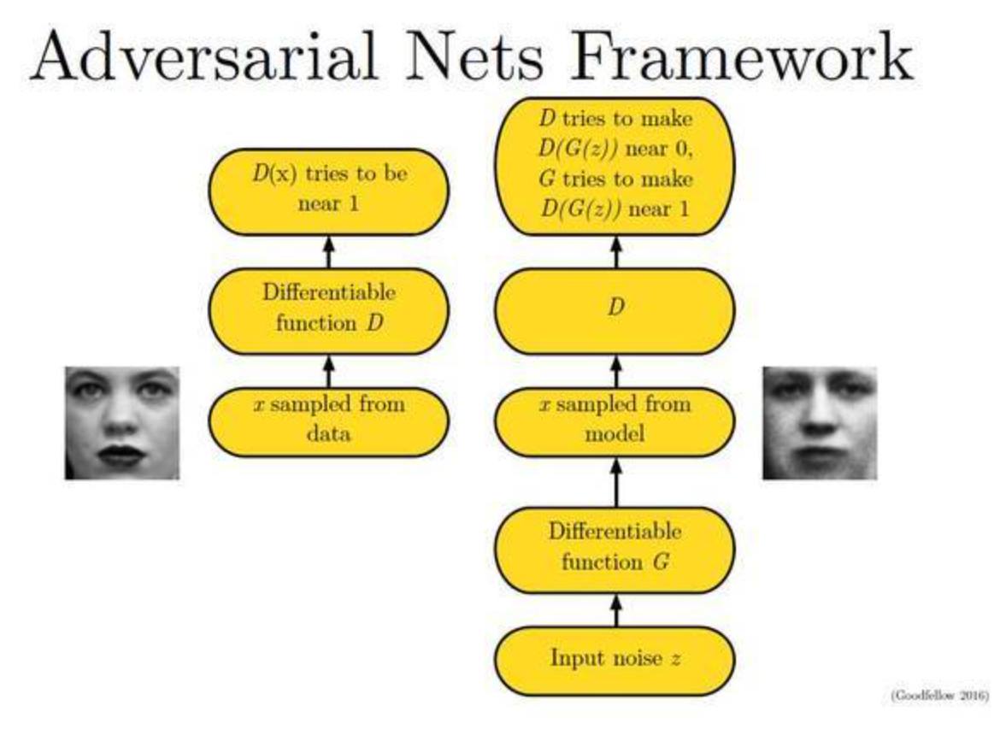
In theory, the solution to this minimax game is where $p_{g}=p_{data}$
 , and the discriminator guesses randomly if the inputs are real or fake. However, the convergence theory of GANs is still being actively researched and in reality models do not always train to this point.





## DCGAN
A DCGAN is a direct extension of the GAN described above, except that it explicitly uses convolutional and convolutional-transpose layers in the discriminator and generator, respectively. The discriminator is made up of strided convolution layers, batch norm layers, and LeakyReLU activations. The input is a 3x64x64 input image and the output is a scalar probability that the input is from the real data distribution. The generator is comprised of convolutional-transpose layers, batch norm layers, and ReLU activations. The input is a latent vector, $z$, that is drawn from a standard normal distribution and the output is a 3x64x64 RGB image. The strided conv-transpose layers allow the latent vector to be transformed into a volume with the same shape as an image.

Compared with GAN, DCGAN makes the following changes:
*   Remove all pooling layers. In $G$, use transposed convolutional layer to do the up-sampling, and in $D$ use convolution with strides to replace pooling computations.

*   Add batch normalization in both $D$ and $G$.

*   Remove all fully-connected layers, convert the network to the fully convolutional network.
*   $G$ use ``ReLU`` as the activation function, and the last layer uses ``tanh``.

*   $D$ chooses ``LeakyReLU`` as the activation function.




## Code Implementation

**Import required packages, load data and define parameters**

In [ ]:
# library import
import torch
import random
import torch.optim as optim
import torchvision.datasets as dsets
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import numpy as np

from torch import nn
from torch.utils.data import DataLoader
from matplotlib.animation import animation


In [ ]:
# Set random seed for reproducibility
rand_seed = 999
print(f"Random seed is: {rand_seed}")
random.seed(rand_seed)
torch.manual_seed(rand_seed)
torch.use_deterministic_algorithms(True) # Needed for reproducibility

Random seed is: 999


In [ ]:
# Hyperparameters define

# Root directory for the dataset
dataroot = "/content/sample_data/data/celeb"

# The number of worker thread for loading the data with DataLoader
workers = 2

# Batch size used for training. In DCGAN paper, the batch size is set to 128
batch_size = 128

# The spatial size of the images for training. In paper, it is defined as 64×64
image_size = 64

# Number of channels in the training images. For color images, it is 3
nc = 3

# Length of latent vector (size of the generator input)
nz = 100

# Size of feature maps in the generator
ngf = 64

# Size of feature maps in the discriminator
ndf = 64

# Number of training epochs
epoch = 5

# beta1 parameter for the Adam optimizer. The paper set it to 0.5.
beta = 0.5

# Learning rate for training. In paper, it is defined as 0.0002
lr = 2e-4

# Number of GPUs available. Use "0" for CPU computation.
ngpu = 1

In [ ]:
# upzip data, if you don't need unzip data, just skip this step
import zipfile

file = zipfile.ZipFile("/content/drive/MyDrive/dataset/dcgan_dataset/img_align_celeba.zip", "r")
for f in file.namelist():
  file.extract(f, "/content/sample_data/data/celeb")

file.close()
print("Done")

Done


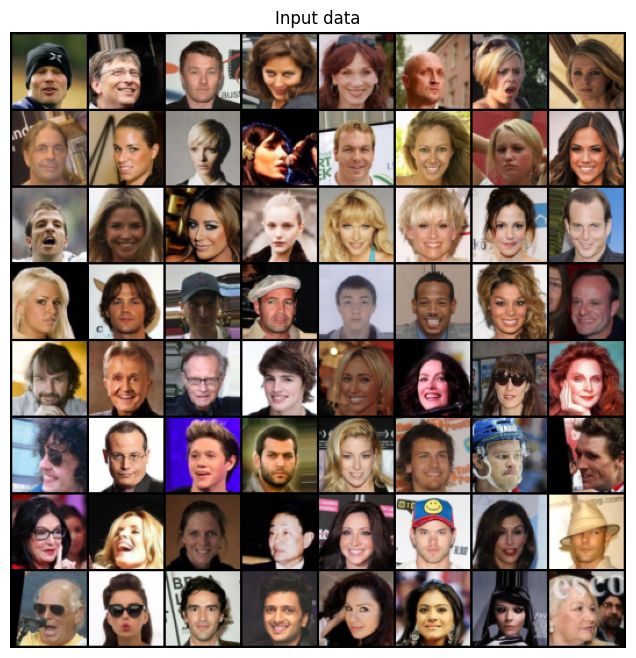

In [ ]:
# Load dataset and preview some data

dataset = dsets.ImageFolder(
    root=dataroot,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
)

data_loader = DataLoader(dataset, batch_size, shuffle=True, num_workers=workers)

device = torch.device(
    "cuda:0"
    if (torch.cuda.is_available() and ngpu > 0)
    else "cpu"
)

# preview some images
view_batch = next(iter(data_loader))
plt.figure(figsize=(8, 8))
plt.title("Input data")
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(view_batch[0].to(device)[:64],padding=2,normalize=True).cpu(), (1,2,0)))

**Weight Initialization**

All models shall be initialized from a Normal Distribution with mean=0 and std=0.02. This function takes an initialized model as an input, and reinitialize all convolutional, convolutional-transpose and batch normalization layers. This function is applied to the models immediately after initialization.

In [ ]:
def weight_init(model):
  classname = model.__class__.__name__
  if classname.find("Conv") != -1:
    nn.init.normal_(model.weight.data, 0.0, 0.02)
  if classname.find("BatchNorm") != -1:
    nn.init.normal_(model.weight.data, 1.0, 0.02)
    nn.init.constant_(model.bias.data, 0)


**Generator**

Generator converts the latent space vector ($z$) to the RGB images with the same size of the training images (3 $\times$ 64 $\times$ 64). In practice, this is accomplished through a series of strided two dimensional convolutional transpose layers, each paired with a 2d batch norm layer and a relu activation. The output of the generator is fed through a tanh function to return it to the input data range of $[−1,1]$. The batch normalization and relu layers are the core of DCGAN.

The structure of the Generator is shown in the figure below:
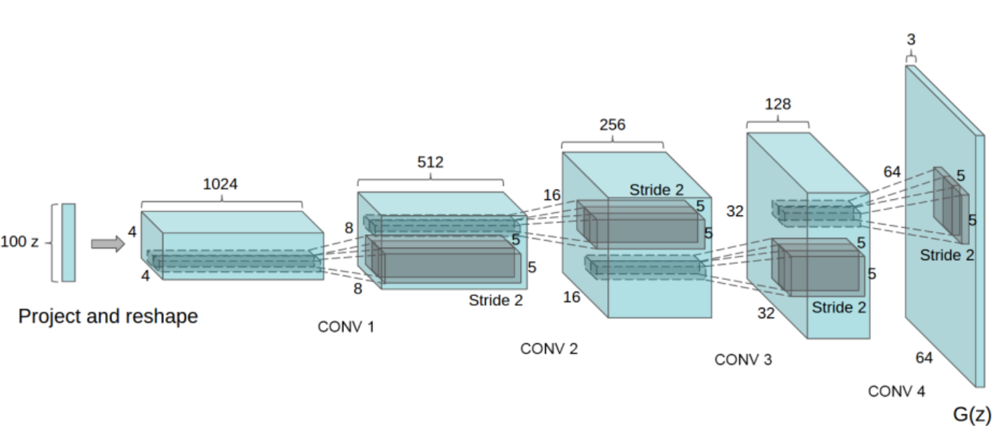

In [ ]:
# Generator Structure

class Generator(nn.Module):
  def __init__(self):
    super(Generator, self).__init__()
    self.main = nn.Sequential(
        # Input latent vector of size nz
        nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
        nn.BatchNorm2d(ngf*8),
        nn.ReLU(True),
        # State size (ngf*8)×4×4
        nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf*4),
        nn.ReLU(True),
        # State size (ngf*4)×8×8
        nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf*2),
        nn.ReLU(True),
        # State size (ngf*2)×16×16
        nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf),
        nn.ReLU(True),
        # State size ngf×32×32
        nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
        nn.Tanh(),
        # State size nc×64×64
    )

  def forward(self, input):
    return self.main(input)

In [ ]:
# Instantiate the generator and do the weight_init
modelG = Generator().to(device)

if (device.type == "cuda") and (ngpu > 1):
  modelG = nn.DataParallel(modelG, list(range(ngpu)))

modelG.apply(weight_init)

print(modelG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


**Discriminator**

Discriminator takes the images of size 3×64×64 as inputs and then outputs a scalar probability to indicate whether the image is real.

The discriminator is composed of a series of Conv2d, BatchNorm2d, and LeakyReLU layers, and finally uses a sigmoid activiation function to generate the probability.

The DCGAN paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both $G$ and $D$.

In [ ]:
# Discriminator structure

class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.main = nn.Sequential(
        # Input image 3*64*64
        nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
        nn.ReLU(True),
        # State size ndf*32*32
        nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf*2),
        nn.ReLU(True),
        # State size (ndf*2)*16*16
        nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf*4),
        nn.ReLU(True),
        # State size (ndf*4)*8*8
        nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ndf*8),
        nn.ReLU(True),
        # State size (ndf*8)*4*4
        nn.Conv2d(ndf*8, 1, 4, 1, 0),
        nn.Sigmoid()
        # output scalar
    )

  def forward(self, input):
    return self.main(input)

In [ ]:
# Instantinate the discriminator
modelD = Discriminator().to(device)

if (device.type == "cuda") and (ngpu > 1):
  modelD = nn.DataParallel(modelD, list(range(ngpu)))

modelD.apply(weight_init)

print(modelD)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): ReLU(inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): ReLU(inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1))
    (12): Sigmoid()
  )
)


**Loss Functions and Optimizers**

Loss function: Binary Cross Entropy Loss (BCE Loss), as shown below.
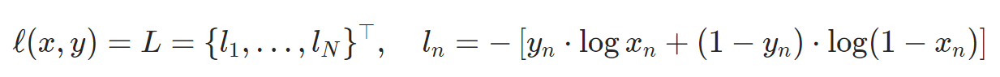

Optimizers: set up two seperate optimizers for $D$ and $G$. Both optimizers are the adam optimizer with learning rate=0.0002 and Beta1=0.5.

For keeping track of the generator’s learning progression, we will generate a fixed batch of latent vectors that are drawn from a Gaussian distribution (i.e. fixed_noise). In the training process, we will periodically input the latent vector into $G$, and over the iterations we will see images form out of the noise.


In [ ]:
# Initialize BCE loss.
loss = nn.BCELoss()

# Define fixed noise for latent vectors
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Define real and fake labels for training
real_label = 1
fake_label = 0

# Define optimizers
optimizerG = optim.Adam(modelG.parameters(), lr=lr, betas=(beta, 0.999))
optimizerD = optim.Adam(modelD.parameters(), lr=lr, betas=(beta, 0.999))

**Training Process**

**Part 1: Training the Discriminator**

For discriminator, the goal is to maximize $log(D(x))+log(1-D(G(z)))$, and we calculate this in two steps. First, we we will construct a batch of real samples from the training set, forward pass through $D$, calculate the loss$(log(D(x)))$, then calculate the gradients in a backward pass. Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through $D$, calculate the loss$(log(1−D(G(z)))$, and accumulate the gradients with a backward pass. Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.

**Part 2: Training the Generator**

For the generator, we would like to minimize $log(1-D(G(z)))$, that is maximizing $log(D(G(z)))$. We accomplish this by: classifying the Generator output from Part 1 with the Discriminator, computing G’s loss using real labels as GT, computing G’s gradients in a backward pass, and finally updating G’s parameters with an optimizer step.

In [ ]:
# Training loop

# Define some parameters
G_losses = list()
D_losses = list()
img_list = list()
iter = 0

print("Starting training process-----------------")
for ep in range(epoch):
  for i, data in enumerate(data_loader, 0):
    ## Train the discriminator
    modelD.zero_grad()
    # Maximize log(D(x))
    # Define data batch
    real_data = data[0].to(device)
    batch_size = real_data.size(0)
    label = torch.full((batch_size, ), real_label, dtype=torch.float, device=device)
    # Forward pass real batch through D
    output = modelD(real_data).view(-1)
    # Calculate loss on all-real batch
    error_real = loss(output, label)
    # Calculate gradients for D in backward pass
    error_real.backward()
    D_x = output.mean().item()

    # Maximize log(1-D(G(z)))
    # Generate latent vector
    noise = torch.randn(batch_size, nz, 1, 1, device=device)\
    # Generate fake images through G
    fake_data = modelG(noise)
    label = label.fill_(fake_label)
    # Forward pass fake batch through D
    output = modelD(fake_data.detach()).view(-1) # Using detach to only update parameters in model D, not update parameters in model G
    # Calculate loss on all-fake batch
    error_fake = loss(output, label)
    # Calculate gradients for D in backward pass
    error_fake.backward()
    D_G_z1 = output.mean().item()
    # Accumulate real-batch error and fake-batch error
    errorD = error_real + error_fake
    # Update D
    optimizerD.step()

    ## Train the generator
    modelG.zero_grad()
    # Maximize log(D(G(z)))
    label = label.fill_(real_label)
    output = modelD(fake_data).view(-1)
    # Calculate loss for G
    errorG = loss(output, label)
    # Backpropagate
    errorG.backward()
    D_G_z2 = output.mean().item()
    # Update G
    optimizerG.step()

    # Output results
    if i%50 == 0:
      print("[%d/%d][%d/%d]\tLoss_D: %.4f\tLossG: %.4f\tD(x): %.4f\tD(G(z)): %.4f/%.4f"
            % (ep+1, epoch, i, len(data_loader), errorD.item(),
               errorG.item(), D_x, D_G_z1, D_G_z2))

    G_losses.append(errorG.item())
    D_losses.append(errorD.item())

    # Save images to show how the generator works
    if (iter%500 == 0) or ((ep==epoch-1) and (i==len(data_loader)-1)):
      with torch.no_grad():
        fake = modelG(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    iter += 1



Starting training process-----------------
[1/5][0/1583]	Loss_D: 1.4966	LossG: 5.1696	D(x): 0.6259	D(G(z)): 0.5659/0.0078
[1/5][50/1583]	Loss_D: 0.1296	LossG: 9.8788	D(x): 0.9632	D(G(z)): 0.0446/0.0001
[1/5][100/1583]	Loss_D: 1.2230	LossG: 14.9503	D(x): 0.5565	D(G(z)): 0.0000/0.0000
[1/5][150/1583]	Loss_D: 1.2120	LossG: 1.7361	D(x): 0.4876	D(G(z)): 0.0026/0.2667
[1/5][200/1583]	Loss_D: 0.7350	LossG: 4.2094	D(x): 0.5958	D(G(z)): 0.0156/0.0287
[1/5][250/1583]	Loss_D: 0.3987	LossG: 5.1605	D(x): 0.7530	D(G(z)): 0.0294/0.0141
[1/5][300/1583]	Loss_D: 0.2458	LossG: 4.4065	D(x): 0.8990	D(G(z)): 0.1051/0.0231
[1/5][350/1583]	Loss_D: 0.2905	LossG: 4.1471	D(x): 0.8528	D(G(z)): 0.0819/0.0388
[1/5][400/1583]	Loss_D: 0.3728	LossG: 3.0097	D(x): 0.9055	D(G(z)): 0.1781/0.0844
[1/5][450/1583]	Loss_D: 2.6650	LossG: 1.0898	D(x): 0.1823	D(G(z)): 0.0006/0.4481
[1/5][500/1583]	Loss_D: 0.3179	LossG: 4.7569	D(x): 0.8674	D(G(z)): 0.0976/0.0175
[1/5][550/1583]	Loss_D: 0.5884	LossG: 4.2038	D(x): 0.6596	D(G(z)): 0

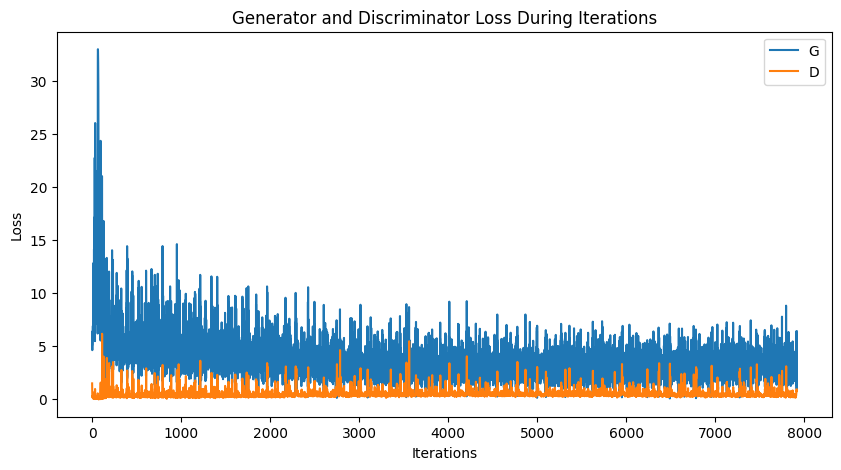

In [ ]:
# Plot loss result
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Iterations")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


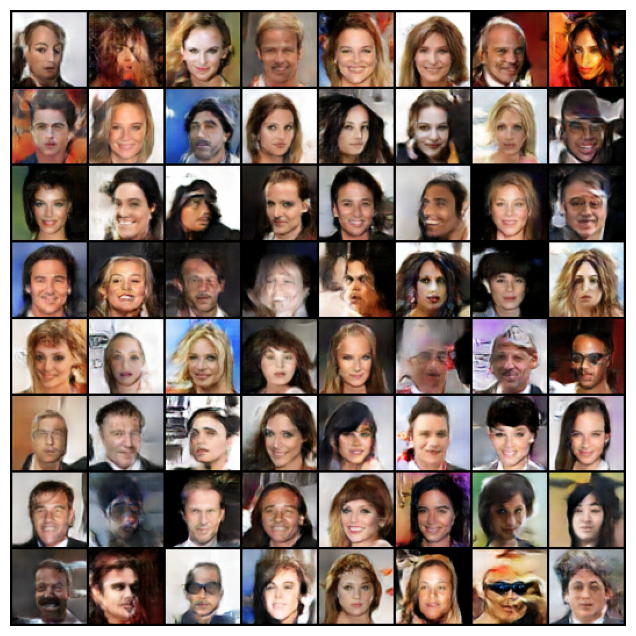

In [ ]:
# Visualization of Generator's process
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1,2,0)))] for i in img_list]
